# Mongo

In [1]:
#!pip3 install pymongo

In [2]:
import pymongo  # importa toda la libreria

In [3]:
cliente=pymongo.MongoClient()  # llamar a la clase MongoClient
db=cliente.nueva_db            # crear una base de datos

In [4]:
cliente.list_database_names()

['admin', 'companies', 'config', 'earthquake', 'geo_attack', 'local', 'supply']

In [5]:
colec=db.n_coleccion   # crea coleccion

In [6]:
db.list_collection_names()

[]

In [7]:
dictio={'nombre':' Juan', 'edad':25}

colec.insert_one(dictio)  # inserta elemento

In [8]:
cliente.list_database_names()

['admin',
 'companies',
 'config',
 'earthquake',
 'geo_attack',
 'local',
 'nueva_db',
 'supply']

In [9]:
db.list_collection_names()

['n_coleccion']

In [10]:
colec.insert_many([
    {'nombre':'Ana', 'edad':45},
    {'saludo':'hola pero que pashhhaa', 'altura':50, 'tiempo':50}
])

# inserta varios

In [11]:
colec.insert_one({'id':0, 'nombre':'Maria', 'edad':45})

In [12]:
colec.insert_one({'_id':0, 'nombre':'Ppepe', 'edad':45}) # cambia id

In [13]:
list(colec.find())   # encuentra todo

[{'_id': ObjectId('5e98cbe9ce973e9243658929'), 'nombre': ' Juan', 'edad': 25},
 {'_id': ObjectId('5e98cc00ce973e924365892a'), 'nombre': 'Ana', 'edad': 45},
 {'_id': ObjectId('5e98cc00ce973e924365892b'),
  'saludo': 'hola pero que pashhhaa',
  'altura': 50,
  'tiempo': 50},
 {'_id': ObjectId('5e98cc04ce973e924365892c'),
  'id': 0,
  'nombre': 'Maria',
  'edad': 45},
 {'_id': 0, 'nombre': 'Ppepe', 'edad': 45}]

In [14]:
list(colec.find().limit(2)) # todo con 2 de limite

[{'_id': ObjectId('5e98cbe9ce973e9243658929'), 'nombre': ' Juan', 'edad': 25},
 {'_id': ObjectId('5e98cc00ce973e924365892a'), 'nombre': 'Ana', 'edad': 45}]

In [15]:
list(colec.find({'edad':25}))  # elemento con edad=25

[{'_id': ObjectId('5e98cbe9ce973e9243658929'), 'nombre': ' Juan', 'edad': 25}]

In [16]:
list(colec.find({'edad': {'$gte': 25}}))  # elemento con edad>=25

[{'_id': ObjectId('5e98cbe9ce973e9243658929'), 'nombre': ' Juan', 'edad': 25},
 {'_id': ObjectId('5e98cc00ce973e924365892a'), 'nombre': 'Ana', 'edad': 45},
 {'_id': ObjectId('5e98cc04ce973e924365892c'),
  'id': 0,
  'nombre': 'Maria',
  'edad': 45},
 {'_id': 0, 'nombre': 'Ppepe', 'edad': 45}]

In [17]:
list(colec.find({'edad': {'$gt': 25}}))  # elemento con edad>25

[{'_id': ObjectId('5e98cc00ce973e924365892a'), 'nombre': 'Ana', 'edad': 45},
 {'_id': ObjectId('5e98cc04ce973e924365892c'),
  'id': 0,
  'nombre': 'Maria',
  'edad': 45},
 {'_id': 0, 'nombre': 'Ppepe', 'edad': 45}]

In [18]:
list(colec.find().sort('edad', -1))   # ordenado por las edad descendente

[{'_id': ObjectId('5e98cc00ce973e924365892a'), 'nombre': 'Ana', 'edad': 45},
 {'_id': ObjectId('5e98cc04ce973e924365892c'),
  'id': 0,
  'nombre': 'Maria',
  'edad': 45},
 {'_id': 0, 'nombre': 'Ppepe', 'edad': 45},
 {'_id': ObjectId('5e98cbe9ce973e9243658929'), 'nombre': ' Juan', 'edad': 25},
 {'_id': ObjectId('5e98cc00ce973e924365892b'),
  'saludo': 'hola pero que pashhhaa',
  'altura': 50,
  'tiempo': 50}]

In [19]:
colec.delete_one({'_id':0})  # borrar un elemento

In [20]:
list(colec.find())

[{'_id': ObjectId('5e98cbe9ce973e9243658929'), 'nombre': ' Juan', 'edad': 25},
 {'_id': ObjectId('5e98cc00ce973e924365892a'), 'nombre': 'Ana', 'edad': 45},
 {'_id': ObjectId('5e98cc00ce973e924365892b'),
  'saludo': 'hola pero que pashhhaa',
  'altura': 50,
  'tiempo': 50},
 {'_id': ObjectId('5e98cc04ce973e924365892c'),
  'id': 0,
  'nombre': 'Maria',
  'edad': 45}]

In [21]:
colec.update_one({'nombre':'Maria', 'id':0}, {'$set': {'nombre': 'Maria Alejandra'}})  # actualizar uno

In [22]:
list(colec.find())

[{'_id': ObjectId('5e98cbe9ce973e9243658929'), 'nombre': ' Juan', 'edad': 25},
 {'_id': ObjectId('5e98cc00ce973e924365892a'), 'nombre': 'Ana', 'edad': 45},
 {'_id': ObjectId('5e98cc00ce973e924365892b'),
  'saludo': 'hola pero que pashhhaa',
  'altura': 50,
  'tiempo': 50},
 {'_id': ObjectId('5e98cc04ce973e924365892c'),
  'id': 0,
  'nombre': 'Maria Alejandra',
  'edad': 45}]

In [23]:
colec.drop()   # elimina coleccion (no te olvides de poner el WHERE XD)

In [24]:
db.list_collection_names()

[]

### geoqueries

In [1]:
from pymongo import MongoClient

In [2]:
cliente=MongoClient('mongodb://localhost:27017')  # cliente , la conexion

In [3]:
db=cliente.companies   # llamada a la base de datos

In [4]:
al_menos_1_ofi=db.companies.find({'offices': {'$not': {'$size':0}}},
                                 {'name':1, '_id':0, 'offices':1})


# devuelve aquellos elemento con oficinas distintas de cero
# solo el nombre y oficinas

In [5]:
import pandas as pd

df=pd.DataFrame(al_menos_1_ofi)
df.head()

,name,offices
0,Wetpaint,"[{'description': '', 'address1': '710 - 2nd Av..."
1,AdventNet,"[{'description': 'Headquarters', 'address1': '..."
2,Zoho,"[{'description': 'Headquarters', 'address1': '..."
3,Digg,"[{'description': None, 'address1': '135 Missis..."
4,Facebook,"[{'description': 'Headquarters', 'address1': '..."


In [6]:
df=df.dropna()

In [15]:
for i in range(len(df.offices[0])):
    print (pd.DataFrame(df.offices[0][i].items()))

              0                 1
0   description                  
1      address1  710 - 2nd Avenue
2      address2        Suite 1100
3      zip_code             98104
4          city           Seattle
5    state_code                WA
6  country_code               USA
7      latitude           47.6031
8     longitude          -122.333
              0                     1
0   description                      
1      address1  270 Lafayette Street
2      address2             Suite 505
3      zip_code                 10012
4          city              New York
5    state_code                    NY
6  country_code                   USA
7      latitude               40.7237
8     longitude              -73.9964


In [19]:
from pandas.io.json import json_normalize


jsnn=df.offices.apply(lambda x: json_normalize(x))

jsnn

#json_normalize(df.offices[0])

0          description              address1    address...
1            description          address1   address2 z...
2            description         address1   address2 zi...
3          description            address1 address2 zip...
4            description          address1 address2 zip...
                               ...                        
13739      description       address1 address2 zip_code...
13740         description               address1     ad...
13741      description       address1 address2 zip_code...
13742      description address1 address2 zip_code      ...
13743      description                       address1  ...
Name: offices, Length: 13744, dtype: object

In [22]:
display(jsnn[0])

,description,address1,address2,zip_code,city,state_code,country_code,latitude,longitude
0,,710 - 2nd Avenue,Suite 1100,98104,Seattle,WA,USA,47.603122,-122.333253
1,,270 Lafayette Street,Suite 505,10012,New York,NY,USA,40.723731,-73.996431


In [25]:
df_n=pd.DataFrame()
for i in range(1000):
    df_n=df_n.append(json_normalize(df.offices[i]), ignore_index=True)

    
df_n

,description,address1,address2,zip_code,city,state_code,country_code,latitude,longitude
0,,710 - 2nd Avenue,Suite 1100,98104,Seattle,WA,USA,47.603122,-122.333253
1,,270 Lafayette Street,Suite 505,10012,New York,NY,USA,40.723731,-73.996431
2,Headquarters,4900 Hopyard Rd.,Suite 310,94588,Pleasanton,CA,USA,37.692934,-121.904945
3,Headquarters,4900 Hopyard Rd,Suite 310,94588,Pleasanton,CA,USA,37.692934,-121.904945
4,None,135 Mississippi St,,94107,San Francisco,CA,USA,37.764726,-122.394523
...,...,...,...,...,...,...,...,...,...
1267,Headquarters,112 Broadway St.,Suite B,27701,Durham,NC,USA,35.996157,-78.902115
1268,Mailing Address,P.O. Box 1411,,27702,Durham,NC,USA,35.993900,-78.898600
1269,Shoeboxed Australia,101/65 Hume St,,2065,Crows Nest,None,AUS,NaN,NaN
1270,None,2180a Dwight Way,None,94704,Berkeley,CA,USA,37.864221,-122.265466


In [31]:
# extrae la primera oficina

def get_first(data):
    data=data['offices']
    
    principal=None
    
    
    if data[0]['latitude'] and data[0]['longitude']:
        # esto ya es una geoquery (geopoint)
        principal={
            'type':'Point',
            'coordinates':[data[0]['longitude'],
                           data[0]['latitude']]
        }
        
    return {'totalOffices': len(data), 
            'lat': data[0]['latitude'],
            'lng': data[0]['longitude'],
            'principal': principal}

In [32]:
first_office=df[['offices']].apply(get_first, result_type='expand', axis=1)

In [33]:
first_office.head()

,totalOffices,lat,lng,principal
0,2.0,47.603122,-122.333253,"{'type': 'Point', 'coordinates': [-122.333253,..."
1,1.0,37.692934,-121.904945,"{'type': 'Point', 'coordinates': [-121.904945,..."
2,1.0,37.692934,-121.904945,"{'type': 'Point', 'coordinates': [-121.904945,..."
3,1.0,37.764726,-122.394523,"{'type': 'Point', 'coordinates': [-122.394523,..."
4,3.0,37.416050,-122.151801,"{'type': 'Point', 'coordinates': [-122.151801,..."


In [34]:
first_office=first_office.dropna()

In [35]:
df=pd.concat([df, first_office], axis=1).drop(columns=['offices']) # solo para el nombre

In [36]:
df.head()

,name,totalOffices,lat,lng,principal
0,Wetpaint,2.0,47.603122,-122.333253,"{'type': 'Point', 'coordinates': [-122.333253,..."
1,AdventNet,1.0,37.692934,-121.904945,"{'type': 'Point', 'coordinates': [-121.904945,..."
2,Zoho,1.0,37.692934,-121.904945,"{'type': 'Point', 'coordinates': [-121.904945,..."
3,Digg,1.0,37.764726,-122.394523,"{'type': 'Point', 'coordinates': [-122.394523,..."
4,Facebook,3.0,37.416050,-122.151801,"{'type': 'Point', 'coordinates': [-122.151801,..."


In [37]:
df=df.dropna()

In [38]:
df.to_json('data/oficinas.json')    # guarda a json

In [39]:
db.first_office.insert_many(df.to_dict('records'))  # inserta en mongo

In [40]:
# crear index 2d

db.first_office.create_index([('principal', '2dsphere')])

'principal_2dsphere'

In [41]:
# encuentra los elementos dentro de cierto radio, hace geoquery

def find_near(geopoint, radio=1000):
    
    return db.first_office.find({'principal':{
        '$near': {'$geometry': geopoint, '$maxDistance':radio}
    }})
    

In [42]:
# ejemplo

park_avenue={'type': 'Point', 'coordinates':[-73.987308, 40.738935]}  # geopoint

radio=10000  # radio de busqueda

n_ofi=find_near(park_avenue, radio).count()

n_ofi

/usr/local/Cellar/ipython/7.8.0/libexec/vendor/lib/python3.7/site-packages/ipykernel_launcher.py:7: DeprecationWarning: count is deprecated. Use Collection.count_documents instead.
  import sys


556

In [43]:
pd.DataFrame(find_near(park_avenue, radio)).head()

,_id,name,totalOffices,lat,lng,principal
0,5e98cd3dce973e924365a6e4,SpaBooker,1.0,40.738567,-73.987199,"{'type': 'Point', 'coordinates': [-73.987199, ..."
1,5e98cd3dce973e92436594bc,HealthiNation,1.0,40.739341,-73.988357,"{'type': 'Point', 'coordinates': [-73.988357, ..."
2,5e98cd3dce973e92436590a4,Special Ops Media,1.0,40.737721,-73.987725,"{'type': 'Point', 'coordinates': [-73.987725, ..."
3,5e98cd3dce973e924365ad36,Mashable,1.0,40.740154,-73.986742,"{'type': 'Point', 'coordinates': [-73.9867417,..."
4,5e98cd3dce973e9243659e3b,Return Path,1.0,40.740207,-73.987002,"{'type': 'Point', 'coordinates': [-73.987002, ..."


# Folium

https://python-visualization.github.io/folium/

In [44]:
#!pip3 install folium

In [45]:
import folium

In [46]:
# crear mapa

mapa=folium.Map(location=[19.41, -99.16], tiles='openstreetmap', zoom_start=12)

In [47]:
# marcador

folium.CircleMarker([19.41, -99.16], radius=10, icon=folium.Icon()).add_to(mapa)

In [48]:
# guarda el mapa

mapa.save('mex.html')

In [49]:
mapa

In [50]:
# otro mapa

mapa2=folium.Map(location=[19.41, -99.16], tiles='stamentoner', zoom_start=12)

lat=[19.42, 19.4, 19.43, 19.39, 19.42, 19.38]
lng=[-99.1, -99.15, -99.13 ,-99.12, -99.09, -99.11]

for i in range(len(lat)):
    folium.Marker([lat[i], lng[i]], icon=folium.Icon(color='red')).add_to(mapa2)
    
    
mapa2.save('mex2.html')

mapa2

In [51]:
import folium
from folium import plugins


m = folium.Map(
    location=[35.68159659061569, 139.76451516151428],
    zoom_start=16
)



# longitud y latitud por orden.
lines = [
    {
        'coordinates': [
            [139.76451516151428, 35.68159659061569],
            [139.75964426994324, 35.682590062684206],
        ],
        'dates': [
            '2017-06-02T00:00:00',
            '2017-06-02T00:10:00'
        ],
        'color': 'red'
    },
    {
        'coordinates': [
            [139.75964426994324, 35.682590062684206],
            [139.7575843334198, 35.679505030038506],
        ],
        'dates': [
            '2017-06-02T00:10:00',
            '2017-06-02T00:20:00'
        ],
        'color': 'blue'
    },
    {
        'coordinates': [
            [139.7575843334198, 35.679505030038506],
            [139.76337790489197, 35.678040905014065],
        ],
        'dates': [
            '2017-06-02T00:20:00',
            '2017-06-02T00:30:00'
        ],
        'color': 'green',
        'weight': 15,
    },
    {
        'coordinates': [
            [139.76337790489197, 35.678040905014065],
            [139.76451516151428, 35.68159659061569],
        ],
        'dates': [
            '2017-06-02T00:30:00',
            '2017-06-02T00:40:00'
        ],
        'color': '#FFFFFF',
    },
]




features = [
    {
        'type': 'Feature',
        'geometry': {
            'type': 'LineString',
            'coordinates': line['coordinates'],
        },
        'properties': {
            'times': line['dates'],
            'style': {
                'color': line['color'],
                'weight': line['weight'] if 'weight' in line else 5
            }
        }
    }
    for line in lines
]







plugins.TimestampedGeoJson({
    'type': 'FeatureCollection',
    'features': features,
}, period='PT1M', add_last_point=True).add_to(m)

#display(m)



m.save('mapa_continuo.html')

m

In [52]:
# heatmap

mapa3=folium.Map([47.603122, -122.333253], zoom_start=4)

data=df[['lat', 'lng']].values

mapa3.add_child(plugins.HeatMap(data, radius=15))

mapa3

In [53]:
# heatmap con movimiento

df=pd.read_csv('data/test_folium.csv')

df.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag
0,id3004672,1,2016-06-30 23:59:58,1,-73.988129,40.732029,-73.990173,40.756680,N
1,id3505355,1,2016-06-30 23:59:53,1,-73.964203,40.679993,-73.959808,40.655403,N
2,id1217141,1,2016-06-30 23:59:47,1,-73.997437,40.737583,-73.986160,40.729523,N
3,id2150126,2,2016-06-30 23:59:41,1,-73.956070,40.771900,-73.986427,40.730469,N
4,id1598245,1,2016-06-30 23:59:33,1,-73.970215,40.761475,-73.961510,40.755890,N


In [54]:
df.shape

(625134, 9)

In [55]:
from folium.plugins import HeatMapWithTime as HMWT
from folium.plugins import HeatMap as HM

In [56]:
# transformar segun datos de tiempo

df.pickup_datetime = pd.to_datetime(df.pickup_datetime, format='%Y-%m-%d %H:%M:%S')

df['month'] = df.pickup_datetime.apply(lambda x: x.month)

df['week'] = df.pickup_datetime.apply(lambda x: x.week)

df['day'] = df.pickup_datetime.apply(lambda x: x.day)

df['hour'] = df.pickup_datetime.apply(lambda x: x.hour)

In [57]:
df.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,month,week,day,hour
0,id3004672,1,2016-06-30 23:59:58,1,-73.988129,40.732029,-73.990173,40.756680,N,6,26,30,23
1,id3505355,1,2016-06-30 23:59:53,1,-73.964203,40.679993,-73.959808,40.655403,N,6,26,30,23
2,id1217141,1,2016-06-30 23:59:47,1,-73.997437,40.737583,-73.986160,40.729523,N,6,26,30,23
3,id2150126,2,2016-06-30 23:59:41,1,-73.956070,40.771900,-73.986427,40.730469,N,6,26,30,23
4,id1598245,1,2016-06-30 23:59:33,1,-73.970215,40.761475,-73.961510,40.755890,N,6,26,30,23


In [58]:
# inicializa el mapa

def generateBaseMap(default_location=[40.693943, -73.985880], default_zoom_start=11):
    
    base_map = folium.Map(location=default_location, 
                          control_scale=True, 
                          zoom_start=default_zoom_start)
    
    return base_map

In [59]:
mapa4=generateBaseMap()

In [60]:
mapa4

In [61]:
# se copia df y mes>4

df_copy = df[df.month>4].copy()
df_copy['count'] = 1

In [62]:
# datos para heatmap

df_copy[['pickup_latitude', 
         'pickup_longitude', 
         'count']].groupby(['pickup_latitude', 
                            'pickup_longitude']).sum().sort_values('count', 
                                                                   ascending=False).head(10)

,,count
pickup_latitude,pickup_longitude,
40.773708,-73.870880,4
40.770012,-73.863403,4
40.774158,-73.873062,4
40.773048,-73.885323,4
40.645302,-73.776703,4
40.774021,-73.872971,4
40.774078,-73.873138,4
40.751221,-73.994087,4
40.773788,-73.870911,4


In [63]:
base_map = generateBaseMap() # crea mapa

HM(data=df_copy[['pickup_latitude', 
                  'pickup_longitude', 
                  'count']].groupby(['pickup_latitude', 
                                     'pickup_longitude']).sum().reset_index().values.tolist(), 
    radius=8, 
        max_zoom=13).add_to(base_map) # pon los datos en heatmap

base_map.save('base_map.html')  # guarda

base_map   # representa

In [64]:
df_hour_list = []
for hour in df_copy.hour.sort_values().unique():
    df_hour_list.append(df_copy.loc[df_copy.hour == hour, 
                                    ['pickup_latitude', 
                                     'pickup_longitude', 
                                     'count']].groupby(['pickup_latitude', 
                                                        'pickup_longitude']).sum().reset_index().values.tolist())

In [65]:
base_map = generateBaseMap(default_zoom_start=11) # crea mapa

HMWT(df_hour_list, 
     radius=5, 
     gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, 
     min_opacity=0.5, 
     max_opacity=0.8, 
     use_local_extrema=True).add_to(base_map) # datos pata heatmap con tiempo


base_map  # representa

In [66]:
base_map.save('mapa.html') # guarda

# Kepler by Uber

In [68]:
#!pip3 install keplergl

In [67]:
import geopandas as gpd
from keplergl import KeplerGl

In [69]:
mex=gpd.read_file('mexico.geojson')   # cargar datos geoespaciales (multipolygon)

mex.head()

,name,created_at,updated_at,cartodb_id,geometry
0,Baja California,2013-12-01T18:59:38,2013-12-01T18:59:38,6,"MULTIPOLYGON (((-112.66384 28.41883, -112.6654..."
1,Sonora,2013-12-01T18:59:38,2013-12-01T18:59:38,7,"MULTIPOLYGON (((-114.88259 32.49215, -114.8809..."
2,Baja California Sur,2013-12-01T18:59:38,2013-12-01T18:59:38,8,"MULTIPOLYGON (((-112.75825 27.97538, -112.7574..."
3,Zacatecas,2013-12-01T18:59:38,2013-12-01T18:59:38,9,"MULTIPOLYGON (((-101.84881 25.01762, -101.8319..."
4,Durango,2013-12-01T18:59:38,2013-12-01T18:59:38,10,"MULTIPOLYGON (((-105.96732 26.78554, -105.9391..."


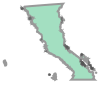

In [70]:
mex.geometry[0]

In [71]:
mex=mex.sort_values(by='name').reset_index()[['name', 'geometry']]  # ordenado por estado
mex.head()

,name,geometry
0,Aguascalientes,"MULTIPOLYGON (((-102.28786 22.41649, -102.2875..."
1,Baja California,"MULTIPOLYGON (((-112.66384 28.41883, -112.6654..."
2,Baja California Sur,"MULTIPOLYGON (((-112.75825 27.97538, -112.7574..."
3,Campeche,"MULTIPOLYGON (((-90.57152 19.82716, -90.57175 ..."
4,Chiapas,"MULTIPOLYGON (((-91.97364 17.91143, -91.96993 ..."


In [73]:
mex['data']=[3*i+3 for i in range(len(mex))]  # datos inventados

mex.head()

,name,geometry,data
0,Aguascalientes,"MULTIPOLYGON (((-102.28786 22.41649, -102.2875...",3
1,Baja California,"MULTIPOLYGON (((-112.66384 28.41883, -112.6654...",6
2,Baja California Sur,"MULTIPOLYGON (((-112.75825 27.97538, -112.7574...",9
3,Campeche,"MULTIPOLYGON (((-90.57152 19.82716, -90.57175 ...",12
4,Chiapas,"MULTIPOLYGON (((-91.97364 17.91143, -91.96993 ...",15


In [74]:
mex=mex.rename(columns={'name':'estado'})

In [75]:
mapa_k=KeplerGl(height=600, width=800)  # inicializas el mapa

mapa_k.add_data(mex, 'Mexico')  # se añaden datos con un nombre

mapa_k.save_to_html(file_name='mapa_kepler.html')  # se guarda

mapa_k # se representa

User Guide: https://github.com/keplergl/kepler.gl/blob/master/docs/keplergl-jupyter/user-guide.md
Map saved to mapa_kepler.html!


KeplerGl(data={'Mexico': {'index': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, …